In [1]:
import pandas as pd
import numpy as np
import math

from prophet import Prophet
from prophet.diagnostics import cross_validation, performance_metrics
from sklearn.metrics import mean_squared_error, mean_absolute_error

import itertools

import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
datos = pd.read_csv("../../data/ml/validation.csv")

In [3]:
fecha_inicio = "2024-09-01"
fecha_fin = "2024-10-31"
train_df = datos[(datos["fecha"] >= fecha_inicio) & (datos["fecha"] <= fecha_fin)]

In [4]:
fecha_inicio_val = "2024-11-01"
fecha_fin_val = "2024-12-31"
val_df = datos[(datos["fecha"] >= fecha_inicio_val) & (datos["fecha"] <= fecha_fin_val)]

In [5]:
test_df = pd.read_csv("../../data/ml/test.csv")

In [6]:
train_df = train_df.rename(columns={"fecha": "ds", "tmed": "y"})
test_df = test_df.rename(columns={"fecha": "ds", "tmed": "y"})
val_df = val_df.rename(columns={"fecha": "ds", "tmed": "y"})

In [7]:
train_df["ds"] = pd.to_datetime(train_df["ds"])
test_df["ds"] = pd.to_datetime(test_df["ds"])
val_df["ds"] = pd.to_datetime(val_df["ds"])

In [8]:
matriz_corr = train_df.corr().round(2)

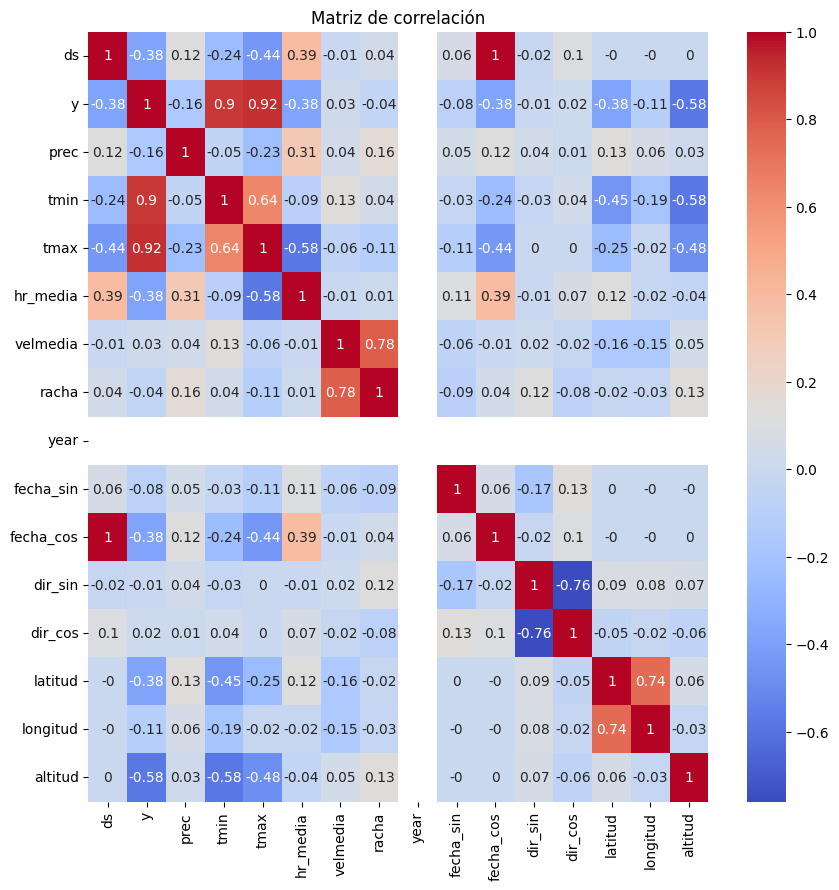

In [9]:
plt.figure(figsize=(10, 10))
sns.heatmap(matriz_corr, annot=True, cmap="coolwarm")
plt.title("Matriz de correlación")
plt.show()

In [39]:
regresores = ["tmin", "tmax","hr_media", "altitud", "prec", "dir_sin", "dir_cos", "velmedia", "racha"]

In [40]:
train_df = train_df.dropna(subset=["ds", "y"])
train_df = train_df.dropna(subset=regresores)

test_df = test_df.dropna(subset=["ds", "y"])
test_df = test_df.dropna(subset=regresores)

val_df = val_df.dropna(subset=["ds", "y"])
val_df = val_df.dropna(subset=regresores)

In [41]:
train_modelo = train_df[["ds", "y"] + regresores]
test_modelo = test_df[["ds", "y"] + regresores]
val_modelo = val_df[["ds", "y"] + regresores]

In [42]:
param_grid = {  
    'changepoint_prior_scale': [0.05, 0.1, 0.5],
    'seasonality_prior_scale': [1.0, 5.0, 10.0],
}

In [43]:
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]
rmses = []

In [44]:
for params in all_params:
    model = Prophet(**params)
    model.fit(train_modelo)
    forecast_val = model.predict(val_modelo[['ds']])
    rmse_val = math.sqrt(mean_squared_error(val_modelo['y'], forecast_val['yhat']))
    rmses.append(rmse_val)

20:38:14 - cmdstanpy - INFO - Chain [1] start processing
20:38:35 - cmdstanpy - INFO - Chain [1] done processing
20:38:49 - cmdstanpy - INFO - Chain [1] start processing
20:39:18 - cmdstanpy - INFO - Chain [1] done processing
20:39:30 - cmdstanpy - INFO - Chain [1] start processing
20:39:51 - cmdstanpy - INFO - Chain [1] done processing
20:40:03 - cmdstanpy - INFO - Chain [1] start processing
20:40:21 - cmdstanpy - INFO - Chain [1] done processing
20:40:33 - cmdstanpy - INFO - Chain [1] start processing
20:40:58 - cmdstanpy - INFO - Chain [1] done processing
20:41:09 - cmdstanpy - INFO - Chain [1] start processing
20:41:35 - cmdstanpy - INFO - Chain [1] done processing
20:41:47 - cmdstanpy - INFO - Chain [1] start processing
20:42:10 - cmdstanpy - INFO - Chain [1] done processing
20:42:22 - cmdstanpy - INFO - Chain [1] start processing
20:42:50 - cmdstanpy - INFO - Chain [1] done processing
20:43:01 - cmdstanpy - INFO - Chain [1] start processing
20:43:33 - cmdstanpy - INFO - Chain [1]

In [45]:
tuning_results = pd.DataFrame(all_params)
tuning_results['rmse'] = rmses
print(tuning_results)

   changepoint_prior_scale  seasonality_prior_scale       rmse
0                     0.05                      1.0   9.360970
1                     0.05                      5.0   9.480938
2                     0.05                     10.0   9.481128
3                     0.10                      1.0  10.774815
4                     0.10                      5.0  11.076651
5                     0.10                     10.0  10.872365
6                     0.50                      1.0  12.915531
7                     0.50                      5.0  13.250137
8                     0.50                     10.0  13.341091


In [46]:
best_params = all_params[np.argmin(rmses)]
print(best_params)

{'changepoint_prior_scale': 0.05, 'seasonality_prior_scale': 1.0}


In [47]:
train_val_df = pd.concat([train_modelo, val_modelo]).reset_index(drop=True)

In [48]:
modelo_final = Prophet(
    changepoint_prior_scale=best_params['changepoint_prior_scale'],
    seasonality_prior_scale=best_params['seasonality_prior_scale']
)
modelo_final.fit(train_val_df)

20:44:27 - cmdstanpy - INFO - Chain [1] start processing
20:45:22 - cmdstanpy - INFO - Chain [1] done processing


In [49]:
future_test = test_modelo[['ds']].copy()
forecast_test = modelo_final.predict(future_test)

In [50]:
final_rmse = math.sqrt(mean_squared_error(test_modelo['y'], forecast_test['yhat']))
print("RMSE en Test:", final_rmse)

RMSE en Test: 5.159327242393497


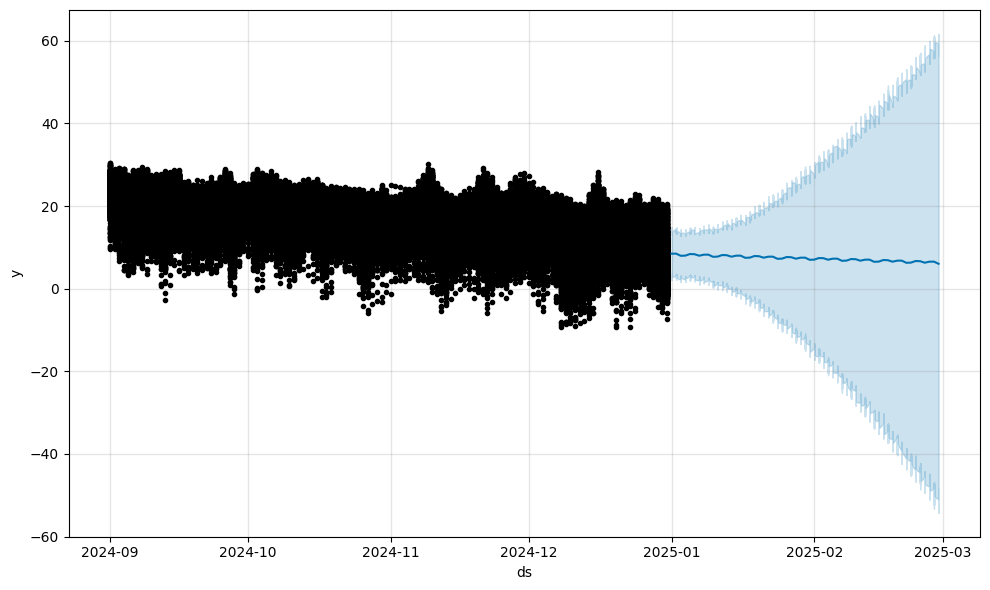

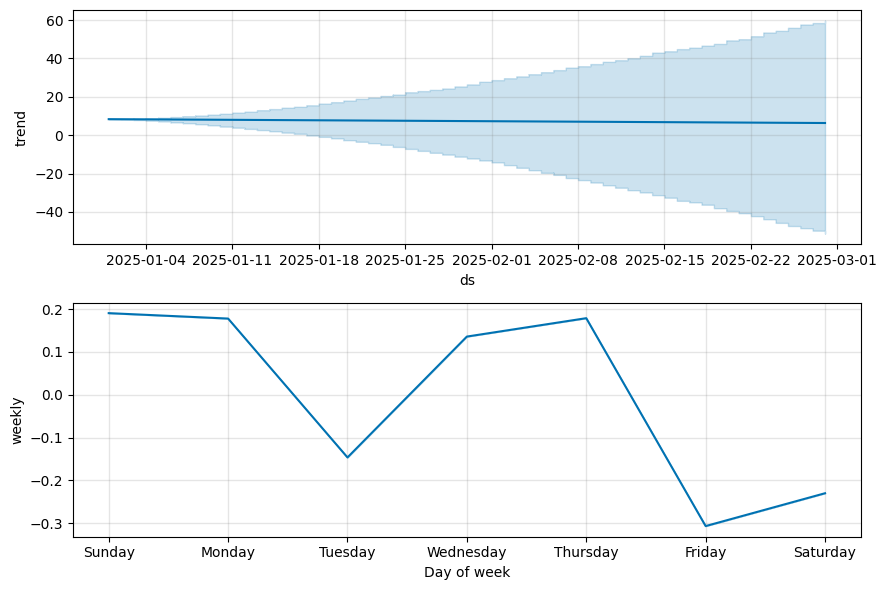

In [51]:
modelo_final.plot(forecast_test)
plt.show()

modelo_final.plot_components(forecast_test)
plt.show()

In [52]:
def granularidad_prophet(train_df, test_df, freq, params, granularidad, periodo):

    train_df['ds'] = pd.to_datetime(train_df['ds'])
    test_df['ds'] = pd.to_datetime(test_df['ds'])
    
    train_resampled = train_df.resample(freq, on="ds").mean().reset_index()
    
    modelo = Prophet(**params)
    modelo.fit(train_resampled)
    
    forecast_test = modelo.predict(test_df[['ds']])

    fig = px.scatter(train_resampled, x="ds", y="y",
                     title=f"Predicción en Test con granularidad: {granularidad}",
                     labels={"ds": "Fecha", "y": "Temperatura media"})
    fig.update_traces(mode="lines+markers", name="Datos de entrenamiento")
    
    fig_pred = px.line(forecast_test, x="ds", y="yhat",
                       labels={"ds": "Fecha", "yhat": "Predicción Test"})
    for trace in fig_pred.data:
        trace.line.dash = "dash"
        trace.name = "Predicción Test"
        fig.add_trace(trace)
    

    fig.add_scatter(
        x=forecast_test["ds"],
        y=forecast_test["yhat_lower"],
        mode="lines",
        line=dict(color="rgba(0,100,80,0.6)", width=1),
        hoverinfo="skip",
        showlegend=False
    )
    
    fig.add_scatter(
        x=forecast_test["ds"],
        y=forecast_test["yhat_upper"],
        mode="lines",
        fill="tonexty",
        fillcolor="rgba(0,100,80,0.2)",
        line=dict(color="rgba(0,100,80,0.6)", width=1),
        hoverinfo="skip",
        showlegend=False
    )
    
    fig.update_layout(showlegend=True)
    fig.show()
    

    predicciones_test = forecast_test[["ds", "yhat", "yhat_lower", "yhat_upper"]]
    print(predicciones_test)


In [53]:
granularidades = {
    "Diario": "D",
    "Semanal": "W",
    "Mensual": "ME",
    "Trimestral": "QE",
    "Semestral": "2QE",
    "Anual": "YE"
}

In [54]:
for nombre, freq in granularidades.items():
    granularidad_prophet(train_val_df,test_modelo, freq, best_params, nombre, periodo=5)

C:\Users\claud\AppData\Local\Temp\ipykernel_21744\4085501992.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

20:45:44 - cmdstanpy - INFO - Chain [1] start processing
20:45:44 - cmdstanpy - INFO - Chain [1] done processing


C:\Users\claud\AppData\Local\Temp\ipykernel_21744\4085501992.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

20:45:56 - cmdstanpy - INFO - Chain [1] start processing


              ds      yhat  yhat_lower  yhat_upper
0     2025-01-01  7.917473    5.974076    9.722126
1     2025-01-01  7.917473    5.968029    9.686403
2     2025-01-01  7.917473    5.877857    9.757193
3     2025-01-01  7.917473    5.904795    9.779507
4     2025-01-01  7.917473    5.912788    9.920535
...          ...       ...         ...         ...
51255 2025-02-28  0.500890   -1.454706    2.311150
51256 2025-02-28  0.500890   -1.359047    2.411924
51257 2025-02-28  0.500890   -1.471502    2.447057
51258 2025-02-28  0.500890   -1.509513    2.342022
51259 2025-02-28  0.500890   -1.463737    2.227282

[51260 rows x 4 columns]


20:45:56 - cmdstanpy - INFO - Chain [1] done processing


C:\Users\claud\AppData\Local\Temp\ipykernel_21744\4085501992.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

20:46:10 - cmdstanpy - INFO - Chain [1] start processing
20:46:10 - cmdstanpy - INFO - Chain [1] done processing


              ds      yhat  yhat_lower  yhat_upper
0     2025-01-01  8.210852    6.794262    9.604662
1     2025-01-01  8.210852    6.832526    9.524950
2     2025-01-01  8.210852    6.867363    9.662166
3     2025-01-01  8.210852    6.758718    9.755672
4     2025-01-01  8.210852    6.919515    9.599639
...          ...       ...         ...         ...
51255 2025-02-28  1.705252    0.324413    3.093974
51256 2025-02-28  1.705252    0.172633    3.127246
51257 2025-02-28  1.705252    0.262762    3.173882
51258 2025-02-28  1.705252    0.302966    3.092187
51259 2025-02-28  1.705252    0.265155    3.033085

[51260 rows x 4 columns]


C:\Users\claud\AppData\Local\Temp\ipykernel_21744\4085501992.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

20:46:23 - cmdstanpy - INFO - Chain [1] start processing


              ds      yhat  yhat_lower  yhat_upper
0     2025-01-01  9.819627    9.142027   10.531033
1     2025-01-01  9.819627    9.109188   10.543474
2     2025-01-01  9.819627    9.107799   10.570417
3     2025-01-01  9.819627    9.100798   10.520909
4     2025-01-01  9.819627    9.198546   10.513852
...          ...       ...         ...         ...
51255 2025-02-28  3.703601    3.016299    4.425225
51256 2025-02-28  3.703601    3.024853    4.410405
51257 2025-02-28  3.703601    3.057538    4.422454
51258 2025-02-28  3.703601    2.999488    4.441040
51259 2025-02-28  3.703601    2.972346    4.408711

[51260 rows x 4 columns]


20:46:25 - cmdstanpy - INFO - Chain [1] done processing


C:\Users\claud\AppData\Local\Temp\ipykernel_21744\4085501992.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

20:46:39 - cmdstanpy - INFO - Chain [1] start processing


              ds       yhat  yhat_lower  yhat_upper
0     2025-01-01  13.255407   13.255407   13.255407
1     2025-01-01  13.255407   13.255407   13.255407
2     2025-01-01  13.255407   13.255407   13.255407
3     2025-01-01  13.255407   13.255407   13.255407
4     2025-01-01  13.255407   13.255407   13.255407
...          ...        ...         ...         ...
51255 2025-02-28   9.581368    9.581368    9.581368
51256 2025-02-28   9.581368    9.581368    9.581368
51257 2025-02-28   9.581368    9.581368    9.581368
51258 2025-02-28   9.581368    9.581368    9.581368
51259 2025-02-28   9.581368    9.581368    9.581368

[51260 rows x 4 columns]


20:46:41 - cmdstanpy - INFO - Chain [1] done processing


              ds       yhat  yhat_lower  yhat_upper
0     2025-01-01  16.168603   16.168603   16.168603
1     2025-01-01  16.168603   16.168603   16.168603
2     2025-01-01  16.168603   16.168603   16.168603
3     2025-01-01  16.168603   16.168603   16.168603
4     2025-01-01  16.168603   16.168603   16.168603
...          ...        ...         ...         ...
51255 2025-02-28  14.311397   14.311397   14.311397
51256 2025-02-28  14.311397   14.311397   14.311397
51257 2025-02-28  14.311397   14.311397   14.311397
51258 2025-02-28  14.311397   14.311397   14.311397
51259 2025-02-28  14.311397   14.311397   14.311397

[51260 rows x 4 columns]


C:\Users\claud\AppData\Local\Temp\ipykernel_21744\4085501992.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



ValueError: Dataframe has less than 2 non-NaN rows.